# Preparation

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

import numpy as np

from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps 

import time

In [ ]:
print("Tensorflow version:", tf.__version__)

if tf.test.gpu_device_name() != '/device:GPU:0':
  print('GPU devices are not available.')
else:
  print('GPU devices are available.')

Tensorflow version: 2.8.0
GPU devices are available.


define functions

In [ ]:
def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read() 
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(filename, format="JPEG", quality=90)
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename

In [ ]:
def draw_bounding_box_on_image(image, ymin, xmin, ymax, xmax, color,font,thickness=4,display_str_list=()):
 
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width, ymin * im_height, ymax * im_height)
  
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top), (left, top)],
            width=thickness, fill=color)   
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height: text_bottom = top
  else: text_bottom = top + total_display_str_height

  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str, fill="black", font=font)
    text_bottom -= text_height - 2 * margin

In [ ]:
def draw_boxes(image, boxes, class_names, scores, max_boxes=50, min_score=0.1):
  colors = list(ImageColor.colormap.values())
  font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",20)

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"), int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(image_pil, ymin, xmin, ymax, xmax, color, font, display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

In [ ]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)

In [ ]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [ ]:
def run_detector(detector, path):
  img = load_img(path)
  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  result = detector(converted_img)

  start_time = time.time()
  result = {key:value.numpy() for key,value in result.items()}
  end_time = time.time()

  print("Found %d objects" %len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)
  
  image_with_boxes = draw_boxes(img.numpy(), result["detection_boxes"], result["detection_class_entities"], result["detection_scores"])
  display_image(image_with_boxes)

# Image url setting

Image downloaded to /tmp/tmphl2i346j.jpg.


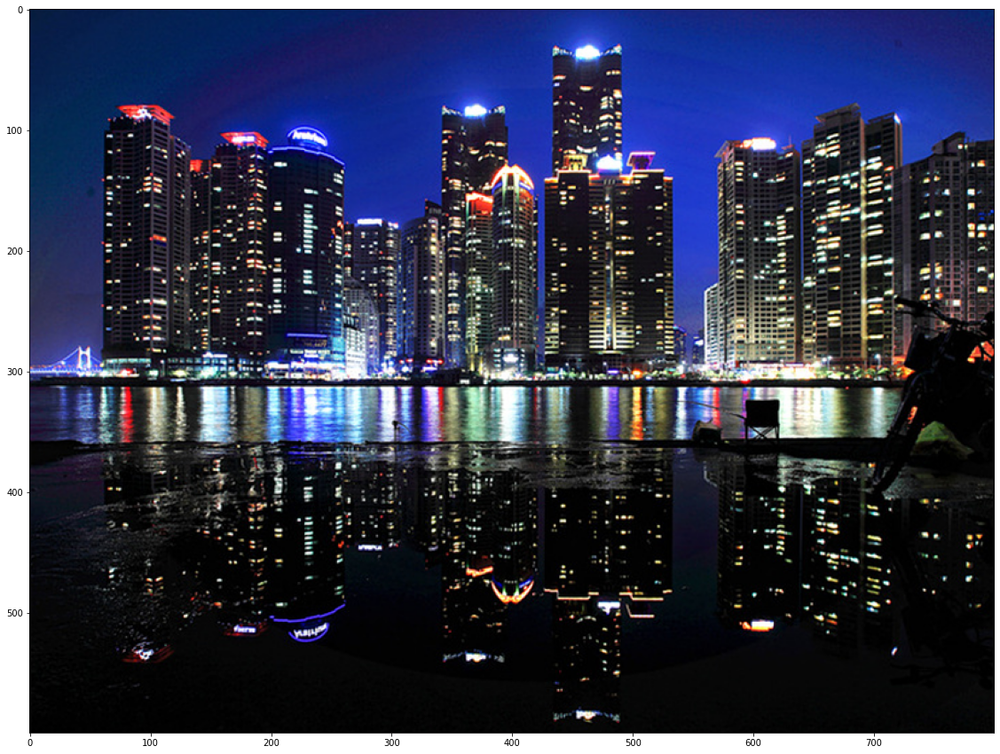

In [ ]:
image_url = "https://postfiles.pstatic.net/20160706_11/hiya74095_1467783832845LpD5V_JPEG/%BA%CE%BB%EA%B8%B6%B8%B0%BD%C3%C6%BC.jpg?type=w1" 
downloaded_image_path = download_and_resize_image(image_url, 800, 600, True)

# Model setting & exercise

In [ ]:
module_handle1 = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"
module_handle2 = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"

detector_faster_Rcnn = hub.load(module_handle1).signatures['default']
detector_ssd = hub.load(module_handle2).signatures['default']

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


Faster-RCNN

Found 100 objects
Inference time:  0.00032138824462890625


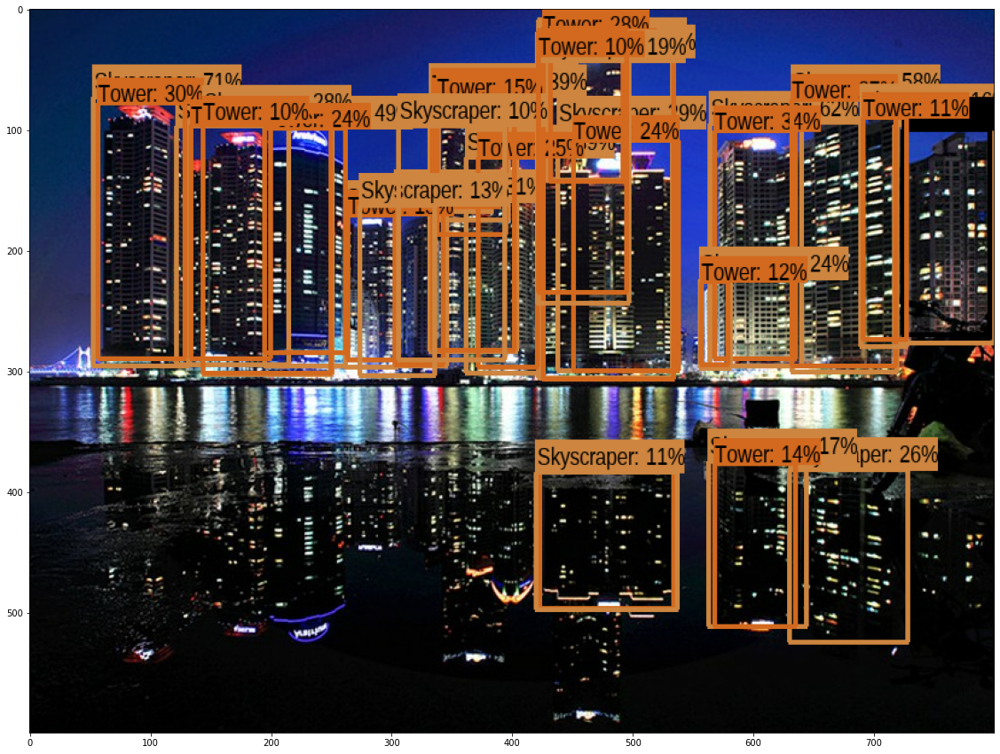

In [ ]:
run_detector(detector_faster_Rcnn, downloaded_image_path)

SSD(Single Shot Multi-box Detector)

Found 100 objects
Inference time:  0.00025844573974609375


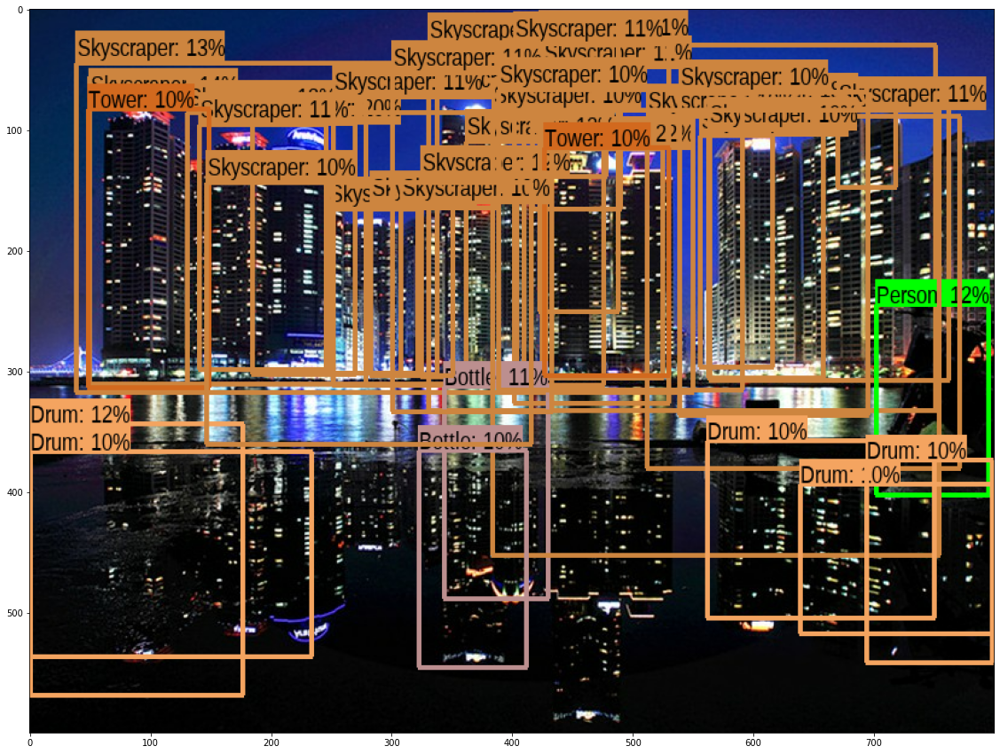

In [ ]:
run_detector(detector_ssd, downloaded_image_path)

# New exercise

In [ ]:
image_urls = [
  "https://www.kgnews.co.kr/data/photos/20210938/art_16322926177579_8d5b90.jpg",
  "https://upload.wikimedia.org/wikipedia/commons/6/60/Naxos_Taverna.jpg",
  'https://upload.wikimedia.org/wikipedia/commons/thumb/0/0d/Biblioteca_Maim%C3%B3nides%2C_Campus_Universitario_de_Rabanales_007.jpg/1024px-Biblioteca_Maim%C3%B3nides%2C_Campus_Universitario_de_Rabanales_007.jpg',
  'https://upload.wikimedia.org/wikipedia/commons/0/09/The_smaller_British_birds_%288053836633%29.jpg',
  'https://upload.wikimedia.org/wikipedia/commons/thumb/f/f0/Comfort_Inn_Gaslamp_more_computers.jpg/180px-Comfort_Inn_Gaslamp_more_computers.jpg',
  'https://search.pstatic.net/common/?src=http%3A%2F%2Fblogfiles.naver.net%2FMjAyMjAyMjFfODgg%2FMDAxNjQ1NDI4NjAxMjcy.4dZY8u4oDm47coSKoS9qmxFhDggJBJ9mGUPPSjlz9_0g.msNvoT4LglyTjA028u3JL_Z9DIZ6-HlAF001eb1Wuxgg.PNG.gustjr5655%2F%25C8%25AD%25B8%25E9_%25C4%25B8%25C3%25B3_2022-02-21_154719_-_%25BA%25B9%25BB%25E7%25BA%25BB.png&type=sc960_832',

  ]

In [ ]:
def detect_img_RCNN(image_url): 
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detector(detector_faster_Rcnn, image_path)
  end_time = time.time()

def detect_img_SSD(image_url): 
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detector(detector_ssd, image_path)
  end_time = time.time()

# Practice Faster R-CNN

Image downloaded to /tmp/tmpx8mdxe03.jpg.
Found 100 objects
Inference time:  0.0004706382751464844


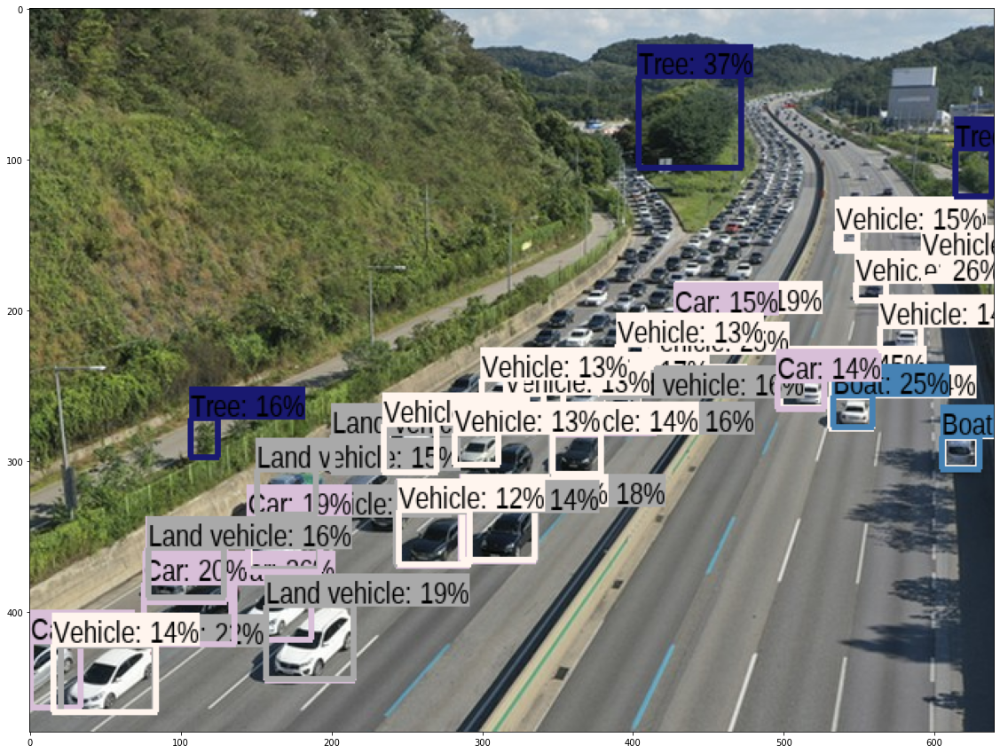

In [ ]:
detect_img_RCNN(image_urls[0])

Image downloaded to /tmp/tmp2282rehy.jpg.
Found 100 objects
Inference time:  0.0004317760467529297


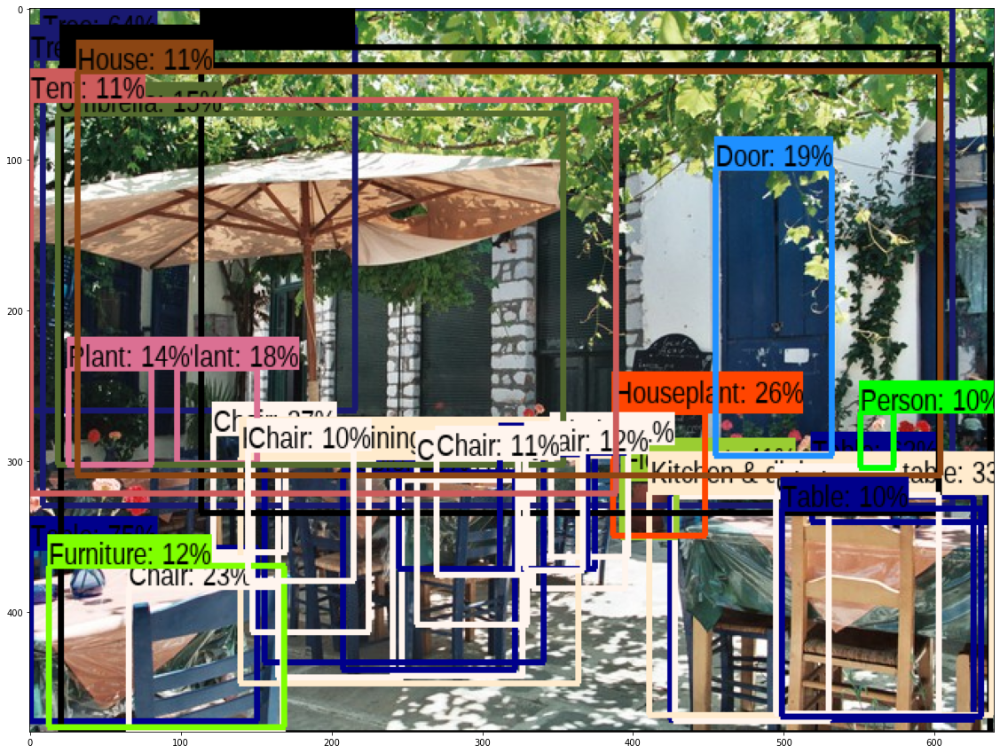

In [ ]:
detect_img_RCNN(image_urls[1])

Image downloaded to /tmp/tmp3tdj4tue.jpg.
Found 100 objects
Inference time:  0.0004596710205078125


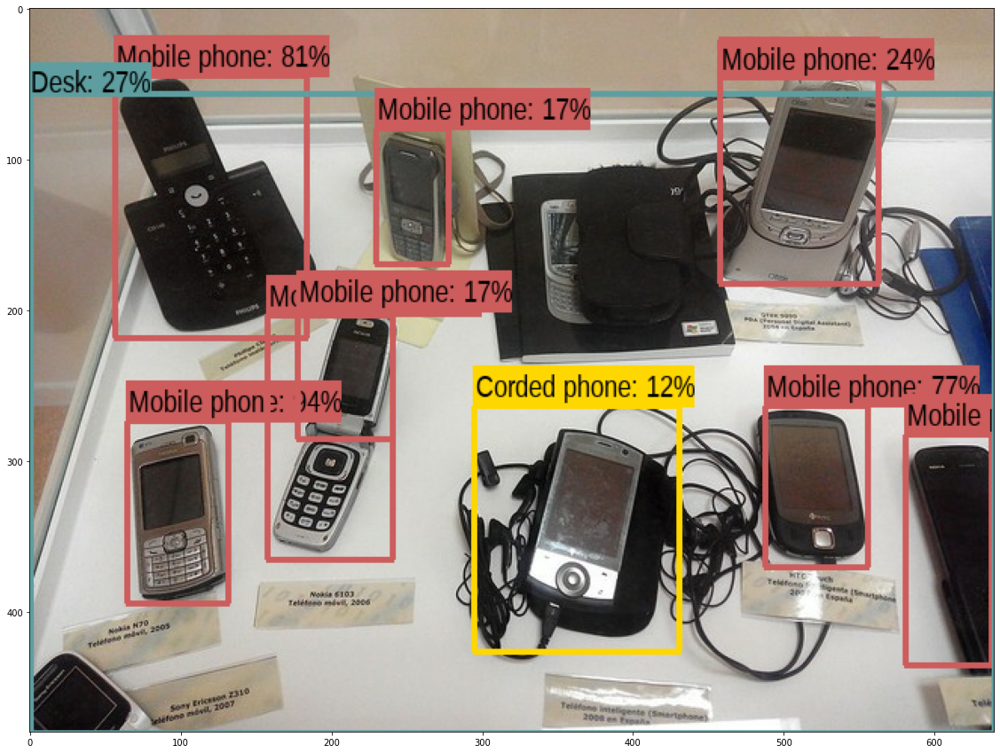

In [ ]:
detect_img_RCNN(image_urls[2])

Image downloaded to /tmp/tmpp0gddq3q.jpg.
Found 100 objects
Inference time:  0.0004076957702636719


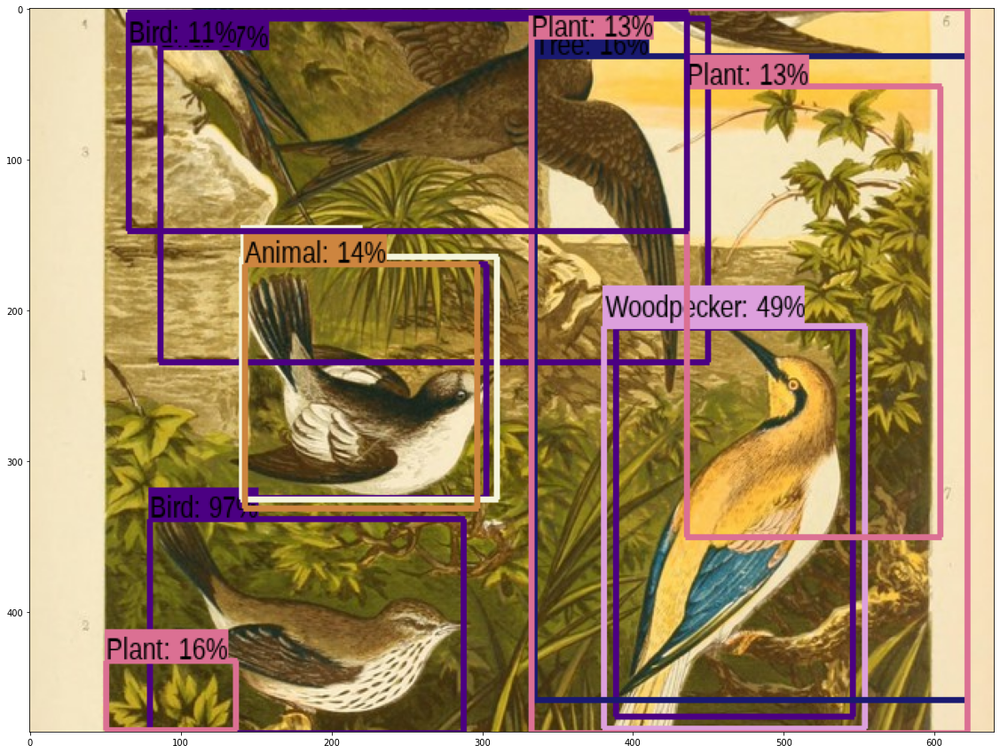

In [ ]:
detect_img_RCNN(image_urls[3])

Image downloaded to /tmp/tmpns4t0e68.jpg.
Found 100 objects
Inference time:  0.0004532337188720703


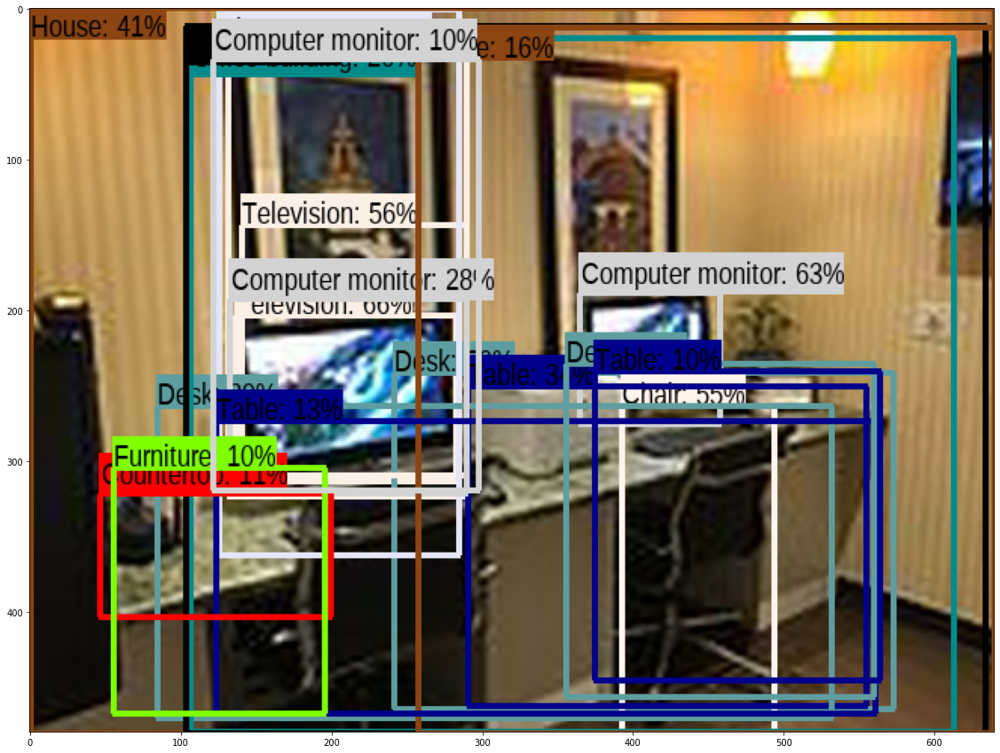

In [ ]:
detect_img_RCNN(image_urls[4])

Image downloaded to /tmp/tmp4qs3ywfb.jpg.
Found 100 objects
Inference time:  0.00033092498779296875


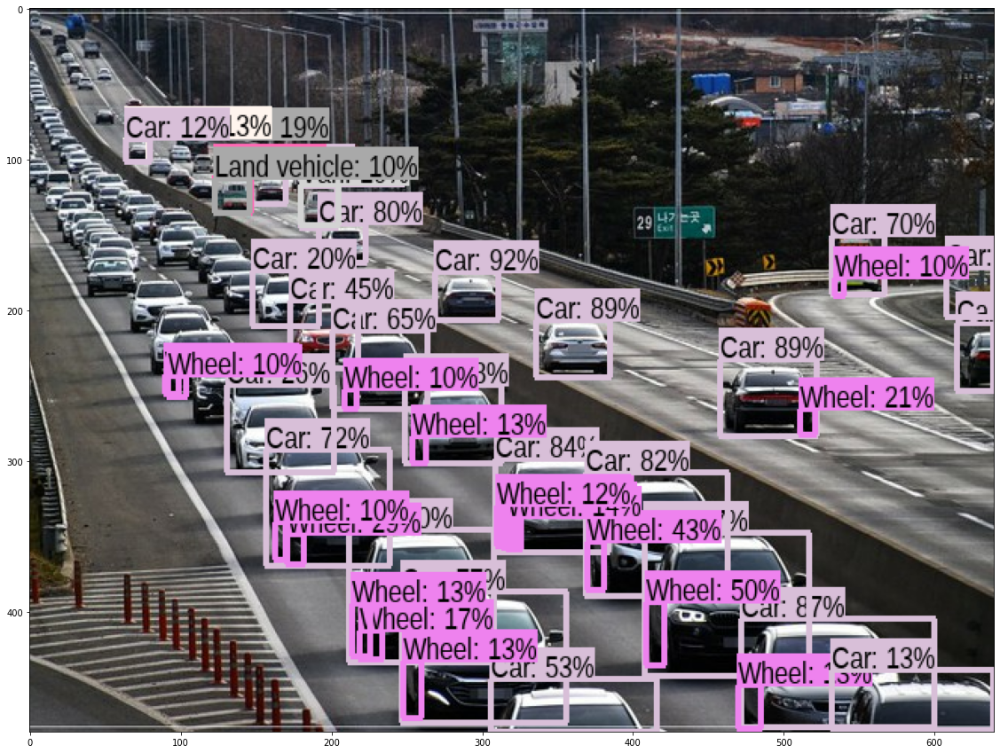

In [ ]:
detect_img_RCNN(image_urls[5])

# Practice SSD 

Image downloaded to /tmp/tmph_fyrej3.jpg.
Found 100 objects
Inference time:  0.0005245208740234375


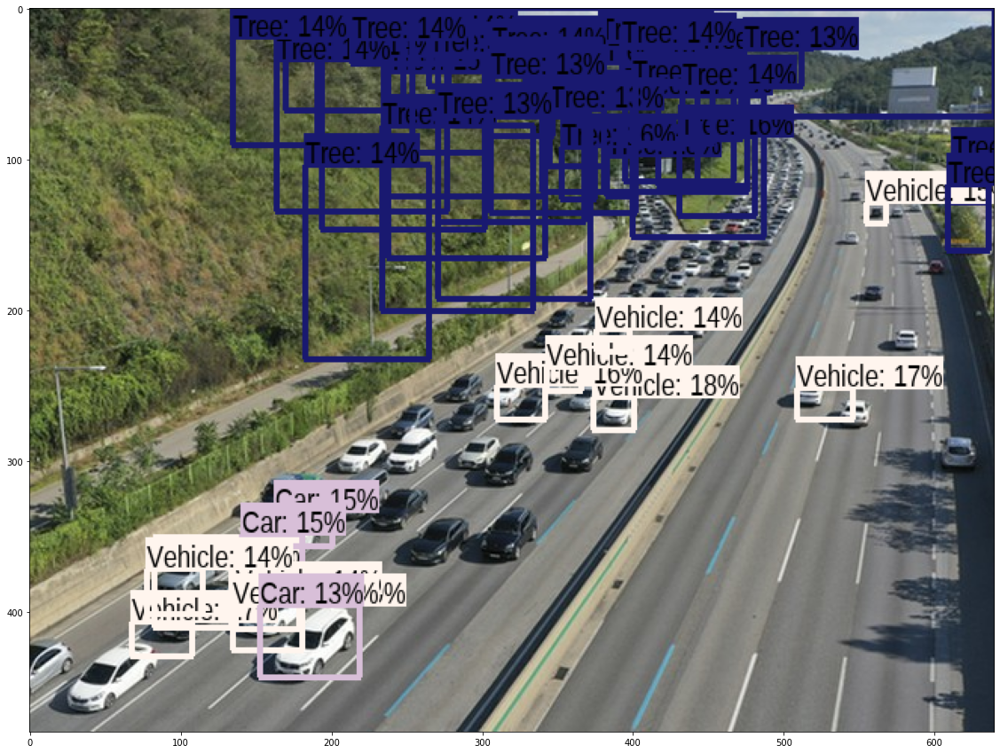

In [ ]:
detect_img_SSD(image_urls[0])

Image downloaded to /tmp/tmpd1k988ja.jpg.
Found 100 objects
Inference time:  0.0002791881561279297


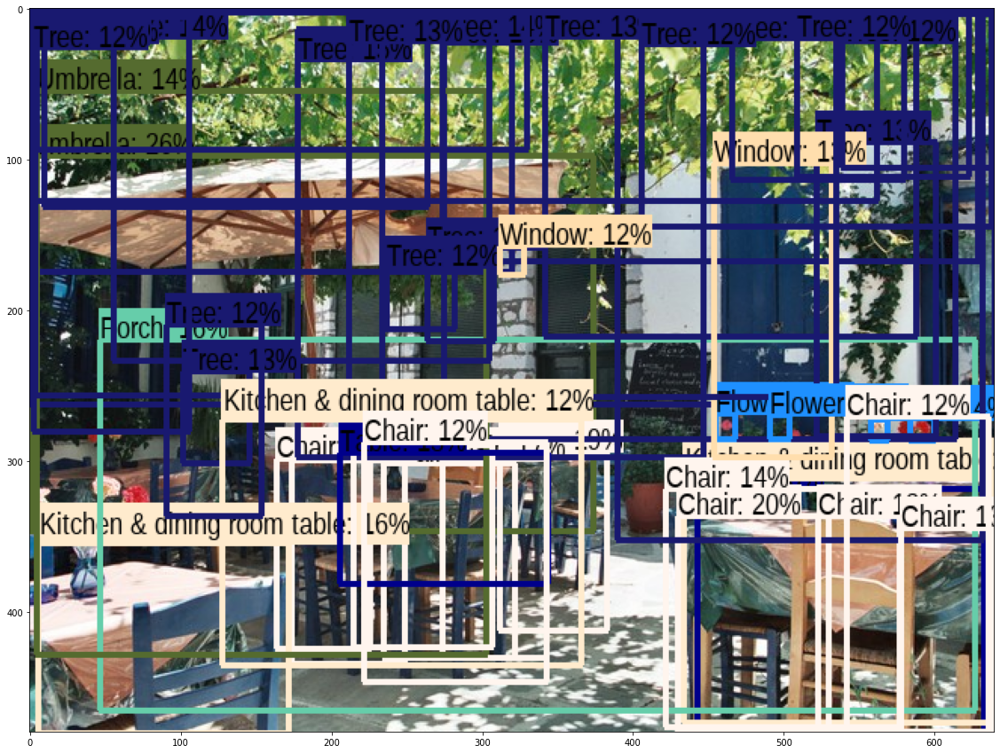

In [ ]:
detect_img_SSD(image_urls[1])

Image downloaded to /tmp/tmpv6fo99_t.jpg.
Found 100 objects
Inference time:  0.0005323886871337891


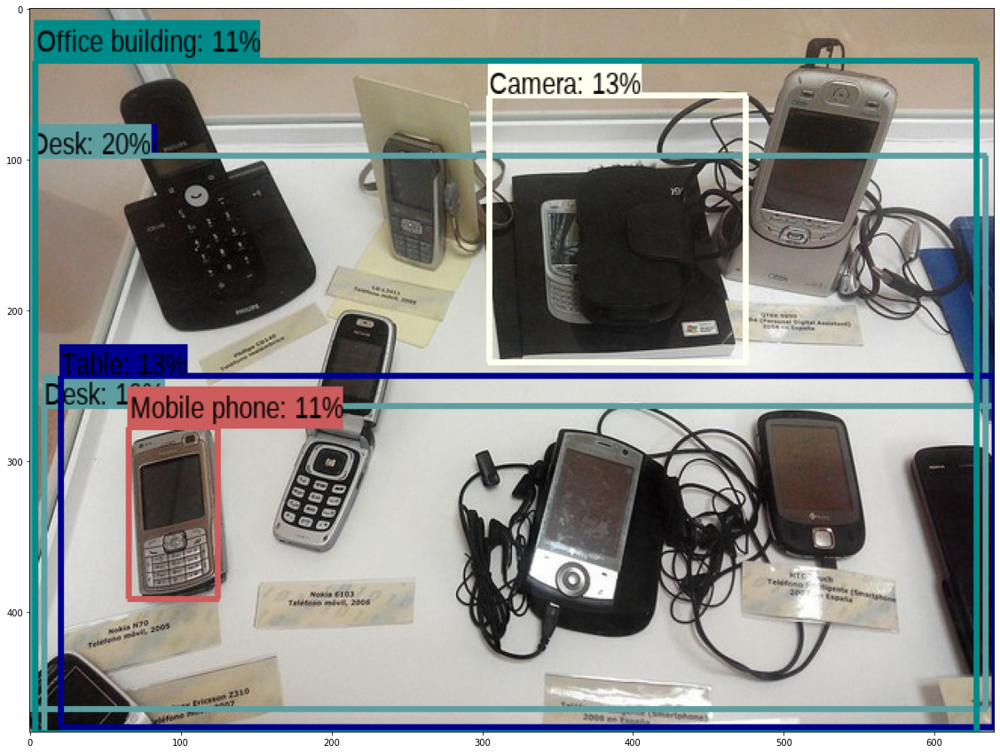

In [ ]:
detect_img_SSD(image_urls[2])

Image downloaded to /tmp/tmpzk3k6_4r.jpg.
Found 100 objects
Inference time:  0.00042748451232910156


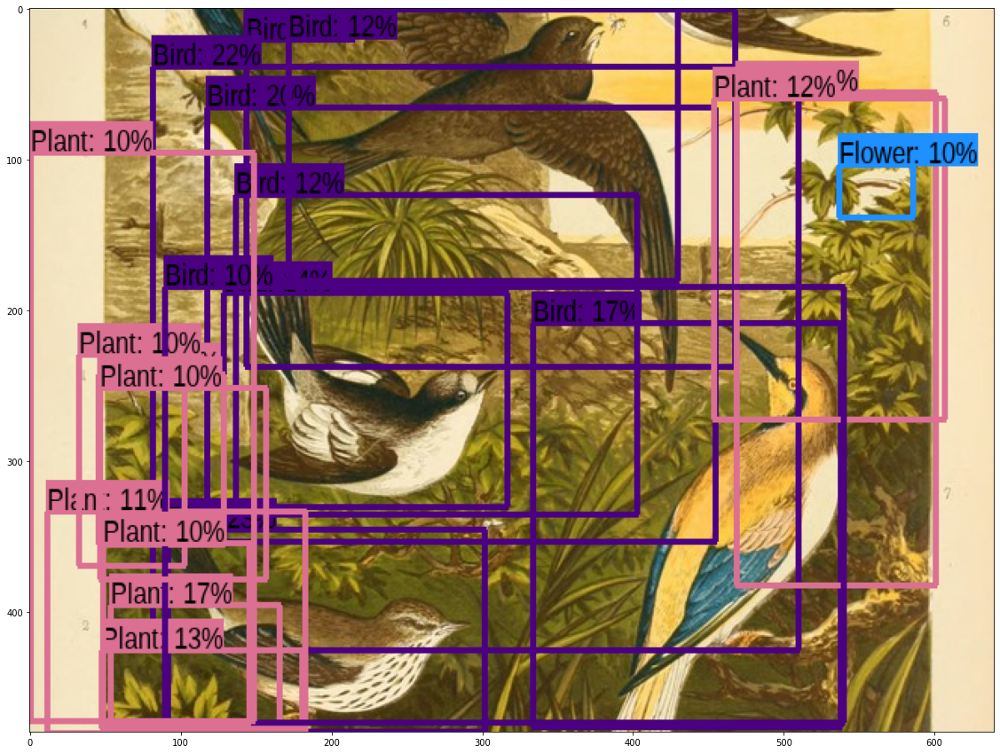

In [ ]:
detect_img_SSD(image_urls[3])

Image downloaded to /tmp/tmpvrcz7qtb.jpg.
Found 100 objects
Inference time:  0.0009307861328125


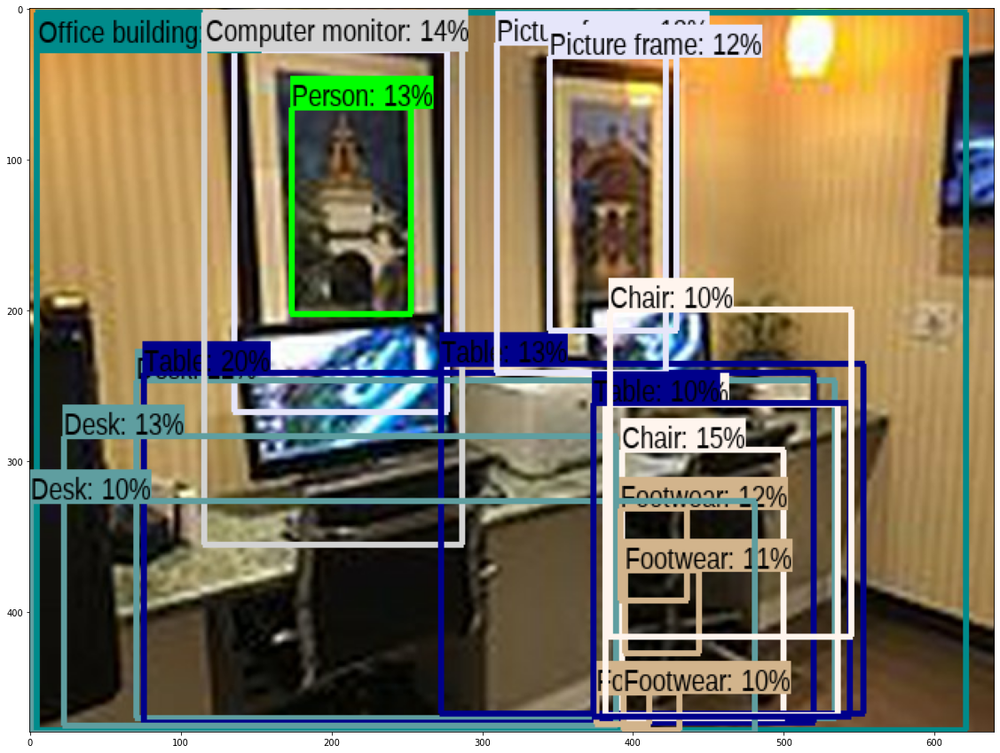

In [ ]:
detect_img_SSD(image_urls[4])

Image downloaded to /tmp/tmp5yom3qvb.jpg.
Found 100 objects
Inference time:  0.00043773651123046875


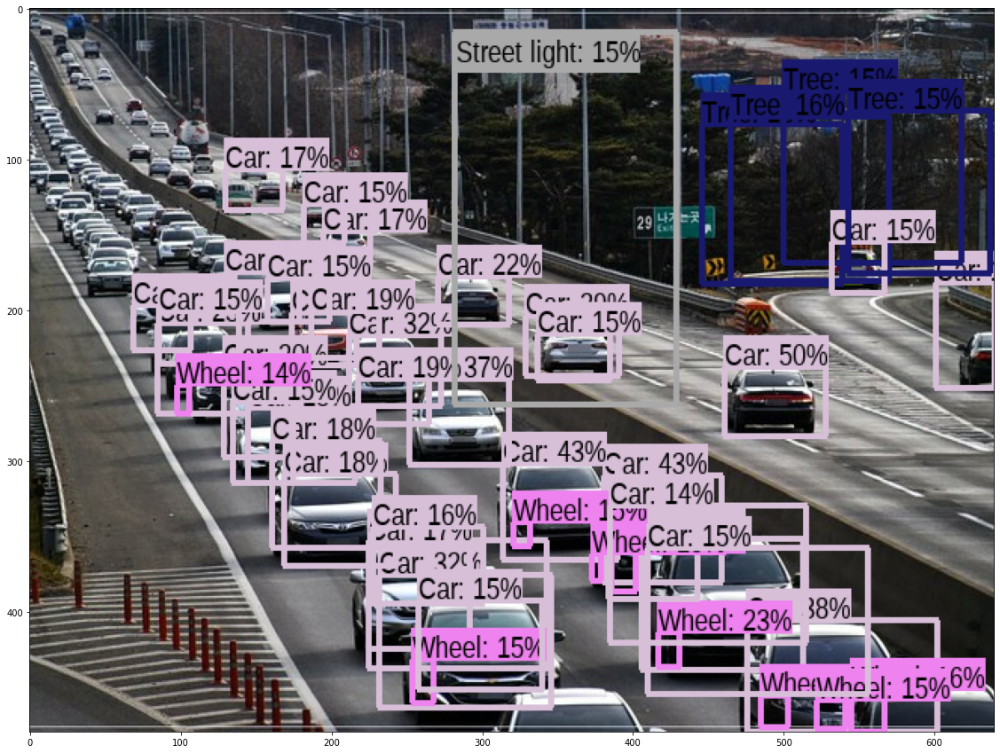

In [ ]:
detect_img_SSD(image_urls[5])